In [2]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import SpectralClustering
from sklearn.cluster import OPTICS
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA
from sklearn.preprocessing import normalize
import numpy as np
import matplotlib.pyplot as plt


In [5]:
ata = pd.read_csv('data/1st_run.csv')
data.head()
X=data.iloc[:,1:].values
# normalize each sample
X_normed =normalize(X,copy=True,axis=1)

In [6]:
def feature_grid_clusters(data,labels,title):
    u_labels = np.unique(labels)
    id = 0
    plt.figure(figsize=(10, 10))
    plt.title(title)
    for i in range(1, data.shape[1]):
        for j in range(1, data.shape[1]):
            id += 1
            plt.subplot(4, 4, id)
            for k in u_labels:
                plt.scatter(data[labels == k, i],
                            data[labels == k, j], label=k)
    plt.show()


In [7]:
def plot_clusters(data,labels,title):
    plt.title(title)
    pca = PCA(2)
    red_data=pca.fit_transform(data)
    u_labels=np.unique(labels)
    for k in u_labels:
        filtered=red_data[labels==k]
        plt.scatter(filtered[0],filtered[1],label=k)


In [8]:
def evaluate_clusterings(X):
    clusters_list=range(2,25+1)
    clusterings=['KMeans','GMM','Agglomerative (Ward)','OPTICS',]
    best_clusterings = []
    best_labels=[]
    plt.figure(figsize=(10, 10))
    cluster_num=len(clusterings)
    if 'OPTICS' in clusterings:
        cluster_num-=1
    if 'DBSCAN' in clusterings:
        cluster_num-=1
    if cluster_num % 2 != 0:
        cluster_num+=1
    for i in range(len(clusterings)):
        clustering=clusterings[i]
        print(f'Evaluating {clustering} clustering')
        scores = []
        labels=[]
        tmp_clusterings = []
        for clusters in clusters_list:
            if clustering == 'KMeans':
                tmp_clustering = KMeans(random_state=0,n_clusters=clusters)
            elif clustering == 'GMM':
                tmp_clustering = GaussianMixture(random_state=0,n_components=clusters)
            elif clustering == 'DBSCAN':
                clusters=clusters/X.shape[1]
                tmp_clustering=DBSCAN(n_jobs=-1,eps=clusters)
            elif clustering == 'OPTICS':
                tmp_clustering=OPTICS(n_jobs=-1,)
            elif 'Agglomerative' in clustering:
                tmp_clustering=AgglomerativeClustering(n_clusters=clusters)
            elif clustering == 'Spectral':
                tmp_clustering=SpectralClustering(random_state=0,n_clusters=clusters)
            labels.append(tmp_clustering.fit_predict(X))
            tmp_clusterings.append(tmp_clustering)
            score=silhouette_score(X, labels[-1]) 
            scores.append(score)
        best = np.argmax(scores)
        #print(f'{clustering} scores: {scores} best id: {best}')
        print(f'best: clusters:{np.unique(labels[best]).shape[0]} score:{scores[best]}')
        best_clusterings.append(tmp_clusterings[best])
        best_labels.append(labels[best])
        if clustering != 'DBSCAN' and clustering !='OPTICS':
            plt.subplot(cluster_num//2,cluster_num//2,i+1)
            plt.title(clustering)
            plt.plot(clusters_list, scores)
    plt.show()
    return best_clusterings,best_labels,clusterings

Evaluating KMeans clustering
best: clusters:2 score:0.836061825687821
Evaluating GMM clustering
best: clusters:2 score:0.7806857232585429
Evaluating Agglomerative (Ward) clustering
best: clusters:2 score:0.836061825687821
Evaluating OPTICS clustering
best: clusters:143 score:-0.23373028561764722


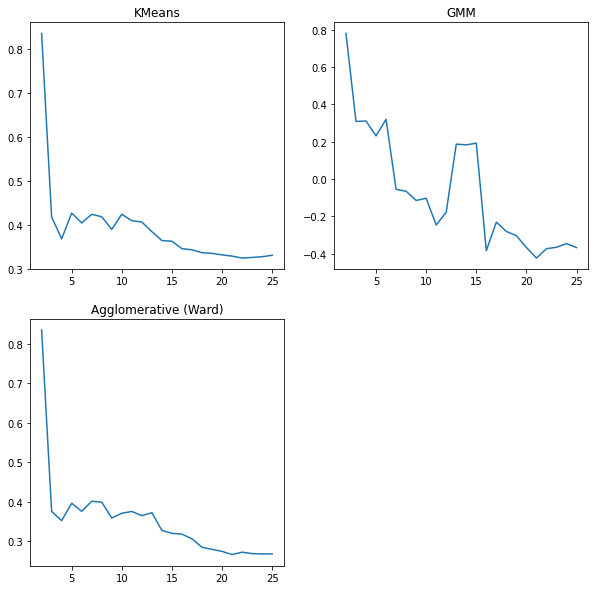

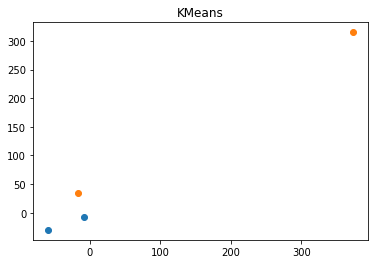

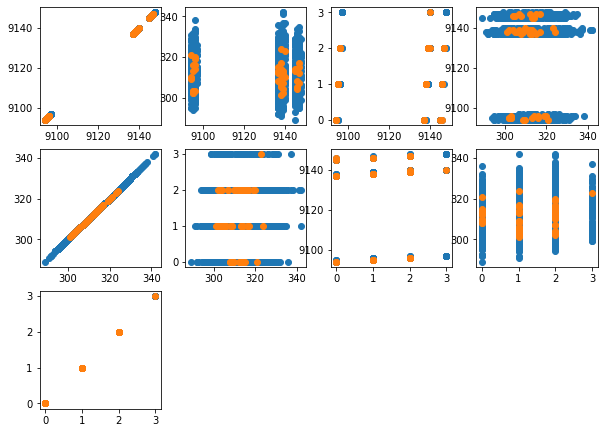

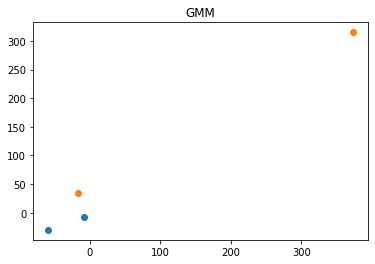

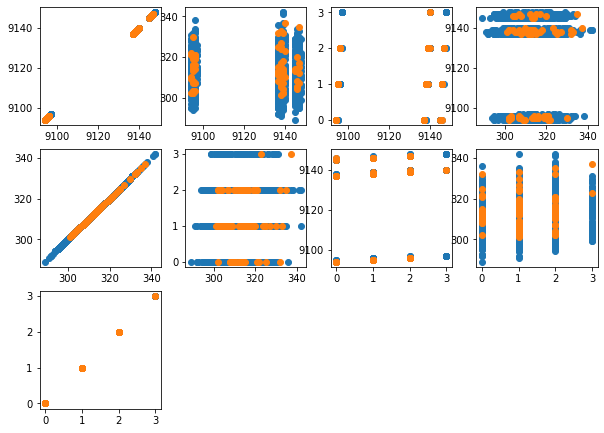

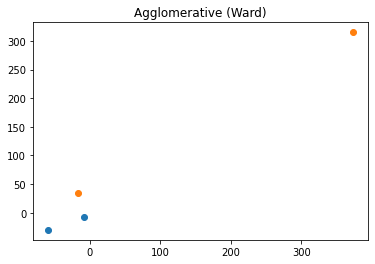

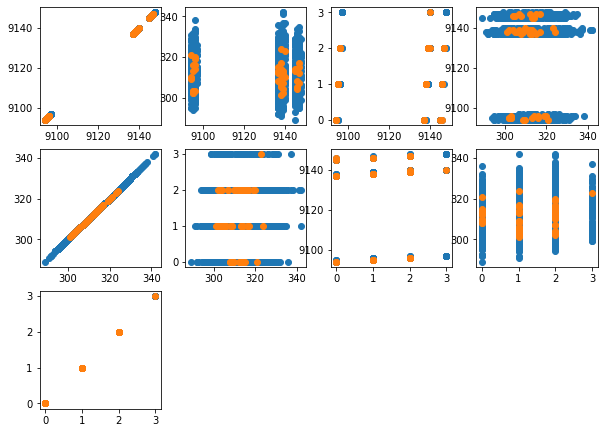

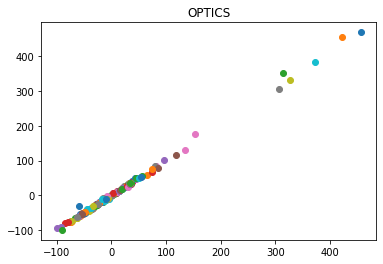

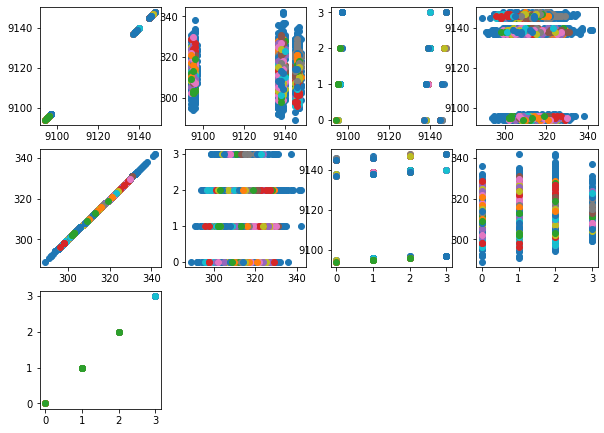

In [9]:
best_clusterings,best_labels,clusterings_str=evaluate_clusterings(X)
for i in range(len(best_clusterings)):
    plot_clusters(X,best_labels[i],clusterings_str[i])
    feature_grid_clusters(X,best_labels[i],clusterings_str[i])

Evaluating KMeans clustering
best: clusters:2 score:0.8564881400919472
Evaluating GMM clustering
best: clusters:2 score:0.8195006044973797
Evaluating Agglomerative (Ward) clustering
best: clusters:2 score:0.8564881400919472
Evaluating OPTICS clustering
best: clusters:135 score:-0.3021782873816891


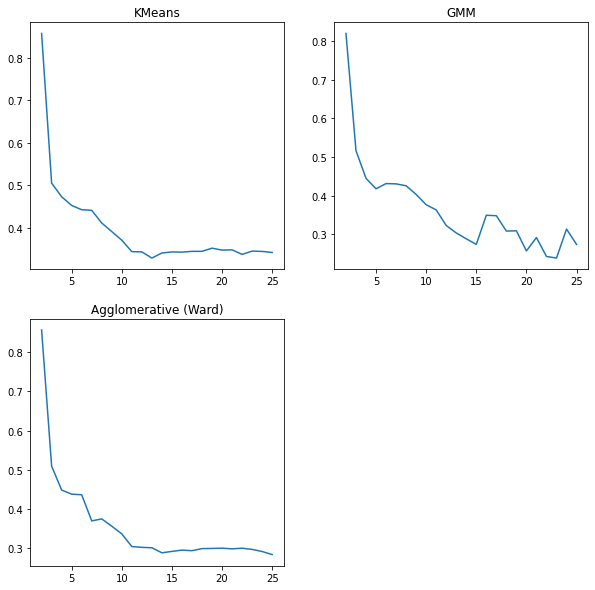

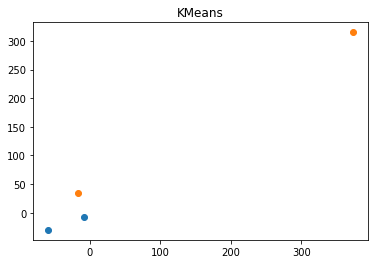

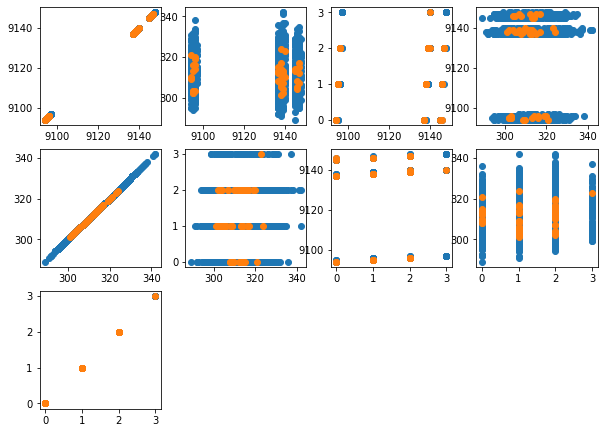

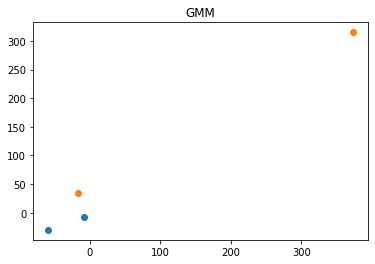

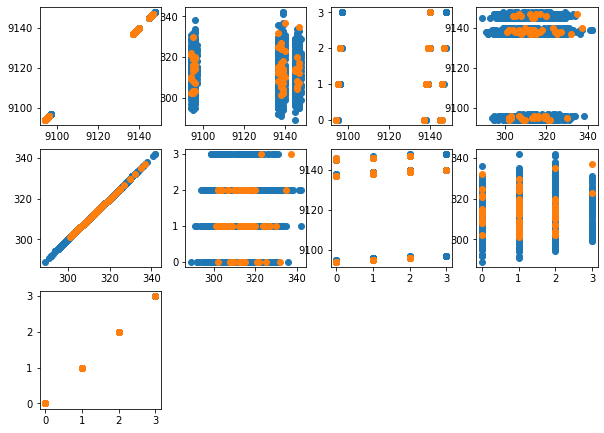

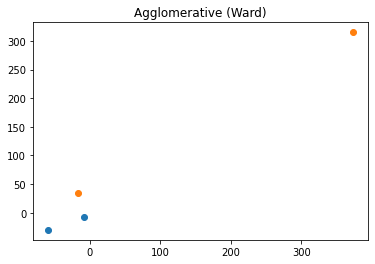

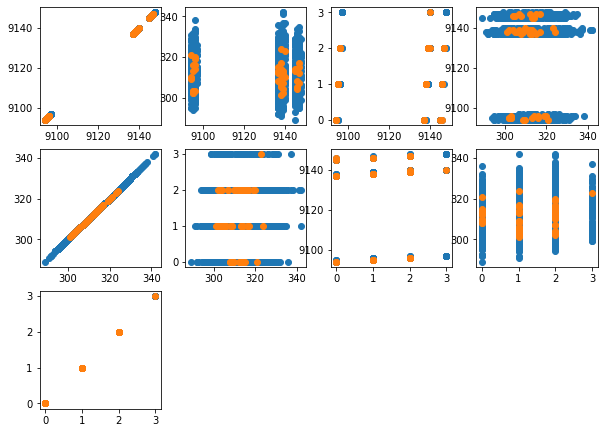

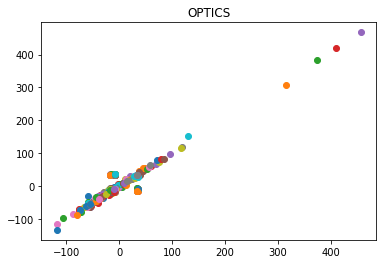

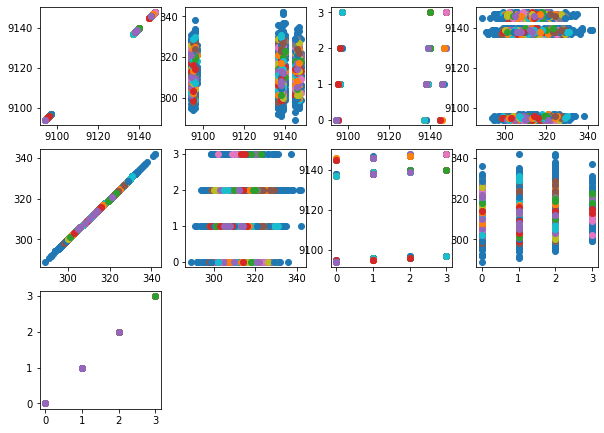

In [10]:
best_clusterings,best_labels,clusterings_str=evaluate_clusterings(X_normed)
for i in range(len(best_clusterings)):
    plot_clusters(X,best_labels[i],clusterings_str[i])
    feature_grid_clusters(X,best_labels[i],clusterings_str[i])